In [1]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib.pyplot import figure
from matplotlib.pyplot import suptitle
import matplotlib.style as style
from IPython.display import display, HTML
import warnings
%config InlineBackend.figure_format = 'png' #set 'png' here when working on notebook
warnings.filterwarnings('ignore') 

# sk learn import 
from sklearn.decomposition import PCA, KernelPCA
from sklearn.metrics import make_scorer

from sklearn.feature_selection import VarianceThreshold, RFE, SelectKBest, chi2
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.linear_model import LogisticRegression
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.ensemble import BaggingClassifier, ExtraTreesClassifier, GradientBoostingClassifier, VotingClassifier, RandomForestClassifier, AdaBoostClassifier

# Set some parameters to get good visuals - style to ggplot and size to 15,10

pd.set_option('display.width',170, 'display.max_rows',200, 'display.max_columns',900)

In [2]:
df = pd.read_csv("/Users/pvaish10/Desktop/TADPOLE_D1_D2.csv")

In [3]:
df['DX'].value_counts()

MCI                3932
NL                 2668
Dementia           1732
MCI to Dementia     372
NL to MCI           108
MCI to NL            77
Dementia to MCI      12
NL to Dementia        3
Name: DX, dtype: int64

In [4]:
print ("Data INFORMATION")
print ("========================\n")


#pd.isnull(df).sum() == 0


Data INFORMATION



#### Select all the columns with few missing values

In [5]:
df1 = df[(pd.isnull(df).sum() == 0).index[(pd.isnull(df).sum() == 0)]]

In [6]:
len(df1.columns)

1452

In [7]:
df1 = df1.drop(['RID',
 'PTID',
 'VISCODE',
 'SITE',
'COLPROT',
 'ORIGPROT',
 'EXAMDATE',
 'DX_bl',
'update_stamp',
                'EXAMDATE_bl',
'VERSION_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16',
 'EXAMDATE_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16',
               'update_stamp_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16',
 'EXAMDATE_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
 'VERSION_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
 'LONISID_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
 'FLDSTRENG_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
 'LONIUID_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
 'IMAGEUID_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
 'RUNDATE_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
 'STATUS_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
               'update_stamp_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
 'EXAMDATE_BAIPETNMRC_09_12_16',
 'VERSION_BAIPETNMRC_09_12_16',
 'LONIUID_BAIPETNMRC_09_12_16',
 'RUNDATE_BAIPETNMRC_09_12_16',
 'STATUS_BAIPETNMRC_09_12_16',
 'update_stamp_BAIPETNMRC_09_12_16',
 'EXAMDATE_UCBERKELEYAV45_10_17_16',
               'update_stamp_UCBERKELEYAV45_10_17_16',
 'EXAMDATE_UCBERKELEYAV1451_10_17_16',
      'update_stamp_UCBERKELEYAV1451_10_17_16',
 'EXAMDATE_DTIROI_04_30_14',
 'VERSION_DTIROI_04_30_14',  
               'RUNDATE_DTIROI_04_30_14',
 'STATUS_DTIROI_04_30_14',
               'update_stamp_DTIROI_04_30_14',
 'EXAMDATE_UPENNBIOMK9_04_19_17',
 'PHASE_UPENNBIOMK9_04_19_17',
 'BATCH_UPENNBIOMK9_04_19_17',
 'KIT_UPENNBIOMK9_04_19_17',
 'STDS_UPENNBIOMK9_04_19_17',
 'RUNDATE_UPENNBIOMK9_04_19_17',
 'update_stamp_UPENNBIOMK9_04_19_17'], 1)

In [8]:
list(df1.columns)[1400:1405]

['AD_RLIC_R_DTIROI_04_30_14',
 'AD_TAP_L_DTIROI_04_30_14',
 'AD_TAP_R_DTIROI_04_30_14',
 'AD_SUMGCC_DTIROI_04_30_14',
 'AD_SUMBCC_DTIROI_04_30_14']

In [9]:
df1.head(4)

,D1,D2,AGE,PTGENDER,PTEDUCAT,PTETHCAT,PTRACCAT,PTMARRY,CDRSB_bl,MMSE_bl,Years_bl,Month_bl,Month,M,FLDSTRENG_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,LONISID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,LONIUID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,IMAGEUID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,RUNDATE_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,STATUS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP1_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP2_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP3_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP4_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP5_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP6_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP7_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP8_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST100SV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST101SV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST102CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST102SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST102TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST102TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST103CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST103SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST103TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST103TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST104CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST104SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST104TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST104TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST105CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST105SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST105TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST105TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST106CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST106SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST106TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST106TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST107CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST107SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST107TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST107TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST108CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST108SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST108TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST108TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST109CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST109SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST109TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST109TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST10CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST110CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST110SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST110TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST110TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST111CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST111SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST111TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST111TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST112SV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST113CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST113SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST113TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST113TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST114CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST114SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST114TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST114TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST115CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST115SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST115TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST115TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST116CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST116SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST116TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST116TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST117CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST117SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST117TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST117TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST118CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST118SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST118TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST118TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST119CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,

#### Select rows which have a DX value

In [10]:
df2 = pd.concat([df1, df['DX']], axis=1)

#### Select rows which have a DX value

In [11]:
df2 = df2.loc[df2['DX'].notnull()]

In [12]:
df2.shape

(8904, 1409)

#### Make only three categories

In [13]:
df2 = df2.replace({'NL to MCI': 'MCI', 'MCI to Dementia': 'Dementia', 'MCI to NL' : 'NL', 'NL to Dementia': 'Dementia', 'Dementia to MCI': 'MCI'})

In [14]:
df2['DX'].value_counts()

MCI         4052
NL          2745
Dementia    2107
Name: DX, dtype: int64

In [15]:
df2.head(1)

,D1,D2,AGE,PTGENDER,PTEDUCAT,PTETHCAT,PTRACCAT,PTMARRY,CDRSB_bl,MMSE_bl,Years_bl,Month_bl,Month,M,FLDSTRENG_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,LONISID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,LONIUID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,IMAGEUID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,RUNDATE_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,STATUS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP1_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP2_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP3_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP4_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP5_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP6_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP7_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP8_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST100SV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST101SV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST102CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST102SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST102TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST102TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST103CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST103SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST103TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST103TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST104CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST104SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST104TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST104TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST105CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST105SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST105TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST105TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST106CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST106SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST106TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST106TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST107CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST107SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST107TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST107TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST108CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST108SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST108TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST108TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST109CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST109SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST109TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST109TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST10CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST110CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST110SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST110TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST110TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST111CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST111SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST111TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST111TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST112SV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST113CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST113SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST113TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST113TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST114CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST114SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST114TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST114TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST115CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST115SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST115TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST115TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST116CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST116SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST116TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST116TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST117CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST117SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST117TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST117TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST118CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST118SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST118TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST118TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST119CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,

In [16]:
df2 = df2.replace({'NL': 1 , 'MCI': 2, 'Dementia': 3})

In [17]:
train_y = df2.DX[df2['D1'] == 1]
test_y = df2.DX[df2['D2'] == 1]

In [18]:
train_y.value_counts()

2    4024
1    2732
3    2085
Name: DX, dtype: int64

In [19]:
test_y.value_counts()

2    2481
1    2059
3     637
Name: DX, dtype: int64

### Feature selection

In [20]:
df2.isna().any().sum()

0

In [21]:
df2.select_dtypes(include=['category','object_']).columns

Index(['PTGENDER', 'PTETHCAT', 'PTRACCAT', 'PTMARRY', 'FLDSTRENG_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16', 'LONISID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16',
       'LONIUID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16', 'IMAGEUID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16', 'RUNDATE_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16',
       'STATUS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16',
       ...
       'AD_SCC_R_DTIROI_04_30_14', 'AD_RLIC_L_DTIROI_04_30_14', 'AD_RLIC_R_DTIROI_04_30_14', 'AD_TAP_L_DTIROI_04_30_14', 'AD_TAP_R_DTIROI_04_30_14',
       'AD_SUMGCC_DTIROI_04_30_14', 'AD_SUMBCC_DTIROI_04_30_14', 'AD_SUMSCC_DTIROI_04_30_14', 'AD_SUMCC_DTIROI_04_30_14', 'AD_SUMFX_DTIROI_04_30_14'],
      dtype='object', length=1398)

In [22]:
categorial_cols = [
    'PTGENDER', 'PTETHCAT', 'PTRACCAT', 'PTMARRY']

for cc in categorial_cols:
    dummies = pd.get_dummies(df2[cc])
    dummies = dummies.add_prefix("{}#".format(cc))
    df2.drop(cc, axis=1, inplace=True)
    df2 = df2.join(dummies)

In [23]:
cols = df2.columns
df2[cols] = df2[cols].apply(pd.to_numeric, errors='coerce')

In [24]:
df2['DX'].value_counts()

2    4052
1    2745
3    2107
Name: DX, dtype: int64

In [25]:
df2 = df2.fillna(0)

In [26]:
train_X = df2[df2['D1'] == 1]
train_X = train_X.drop(['D1','D2','DX'], 1)
test_X = df2[df2['D2'] == 1]
test_X = test_X.drop(['D1','D2','DX'], axis = 1)


In [27]:
train_X.head(1)

,AGE,PTEDUCAT,CDRSB_bl,MMSE_bl,Years_bl,Month_bl,Month,M,FLDSTRENG_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,LONISID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,LONIUID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,IMAGEUID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,RUNDATE_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,STATUS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP1_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP2_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP3_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP4_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP5_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP6_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP7_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,BASETP8_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST100SV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST101SV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST102CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST102SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST102TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST102TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST103CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST103SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST103TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST103TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST104CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST104SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST104TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST104TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST105CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST105SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST105TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST105TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST106CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST106SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST106TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST106TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST107CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST107SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST107TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST107TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST108CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST108SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST108TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST108TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST109CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST109SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST109TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST109TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST10CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST110CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST110SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST110TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST110TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST111CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST111SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST111TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST111TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST112SV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST113CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST113SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST113TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST113TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST114CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST114SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST114TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST114TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST115CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST115SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST115TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST115TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST116CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST116SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST116TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST116TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST117CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST117SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST117TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST117TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST118CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST118SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST118TA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST118TS_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST119CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16,ST119SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_

In [28]:
df2.DX[df2['D1'] == 1].value_counts()

2    4024
1    2732
3    2085
Name: DX, dtype: int64

#### Variance Threshold

In [29]:
#Find all features with more than 90% variance in values.
threshold = 0.90
vt = VarianceThreshold().fit(train_X )

# Find feature names
feat_var_threshold = train_X.columns[vt.variances_ > threshold * (1-threshold)]
feat_var_threshold [:20]

Index(['AGE', 'PTEDUCAT', 'CDRSB_bl', 'MMSE_bl', 'Years_bl', 'Month_bl', 'Month', 'M', 'FLDSTRENG_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16',
       'LONISID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16', 'LONIUID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16', 'IMAGEUID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16',
       'BASETP1_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16', 'BASETP2_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16', 'BASETP3_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16',
       'BASETP4_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16', 'BASETP5_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16', 'ST101SV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16',
       'ST102CV_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16', 'ST102SA_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16'],
      dtype='object')

In [30]:
#Random Forest
model = RandomForestClassifier()
model.fit(train_X, train_y)

feature_imp = pd.DataFrame(model.feature_importances_, index=train_X.columns, columns=["importance"])
feat_imp_20 = feature_imp.sort_values("importance", ascending=False).head(20).index
feat_imp_20

Index(['CDRSB_bl', 'MMSE_bl', 'AGE', 'Years_bl', 'Month_bl', 'PTEDUCAT', 'ST71SV_UCSFFSX_11_02_15_UCSFFSX51_08_01_16', 'ST88SV_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
       'ST40TA_UCSFFSX_11_02_15_UCSFFSX51_08_01_16', 'Month', 'ST85TA_UCSFFSX_11_02_15_UCSFFSX51_08_01_16', 'ST83TA_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
       'ST29SV_UCSFFSX_11_02_15_UCSFFSX51_08_01_16', 'ST30SV_UCSFFSX_11_02_15_UCSFFSX51_08_01_16', 'M', 'ST91TA_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
       'ST58TA_UCSFFSX_11_02_15_UCSFFSX51_08_01_16', 'ST32TA_UCSFFSX_11_02_15_UCSFFSX51_08_01_16', 'ST26TA_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
       'ST12SV_UCSFFSX_11_02_15_UCSFFSX51_08_01_16'],
      dtype='object')

#### Univariate feature selection
Select top 20 features using chi2chi2 test. Features must be positive before applying test.

In [31]:
X_minmax = MinMaxScaler(feature_range=(0,1)).fit_transform(train_X)
X_scored = SelectKBest(score_func=chi2, k='all').fit(X_minmax, train_y)
feature_scoring = pd.DataFrame({
        'feature': train_X.columns,
        'score': X_scored.scores_
    })

feat_scored_20 = feature_scoring.sort_values('score', ascending=False).head(20)['feature'].values
feat_scored_20

array(['CDRSB_bl', 'BASETP4_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16',
       'MMSE_bl', 'BASETP6_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16',
       'ST30SV_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
       'ST89SV_UCSFFSX_11_02_15_UCSFFSX51_08_01_16',
       'RIGHT_HIPPOCAMPUS_SIZE_UCBERKELEYAV45_10_17_16',
       'LEFT_AMYGDALA_SIZE_UCBERKELEYAV45_10_17_16',
       'CTX_LH_ENTORHINAL_SIZE_UCBERKELEYAV45_10_17_16',
       'LEFT_HIPPOCAMPUS_SIZE_UCBERKELEYAV45_10_17_16',
       'RIGHT_AMYGDALA_SIZE_UCBERKELEYAV45_10_17_16',
       'CTX_RH_ENTORHINAL_SIZE_UCBERKELEYAV45_10_17_16',
       'CTX_LH_INFERIORTEMPORAL_SIZE_UCBERKELEYAV45_10_17_16',
       'CTX_RH_INFERIORTEMPORAL_SIZE_UCBERKELEYAV45_10_17_16',
       'PTMARRY#Never married',
       'CTX_LH_MIDDLETEMPORAL_SIZE_UCBERKELEYAV45_10_17_16',
       'CTX_LH_FUSIFORM_SIZE_UCBERKELEYAV45_10_17_16',
       'CTX_RH_MIDDLETEMPORAL_SIZE_UCBERKELEYAV45_10_17_16',
       'CTX_LH_SUPERIORTEMPORAL_SIZE_UCBERKELEYAV45_10_17_16',
       'CTX_LH_INFERIORPA

#### Recursive Feature Elimination
Select 20 features from using recursive feature elimination (RFE) with logistic regression model.

In [32]:
# rfe = RFE(LogisticRegression(), 20)
# rfe.fit(train_X, train_y)

# feature_rfe_scoring = pd.DataFrame({
#         'feature': train_X.columns,
#         'score': rfe.ranking_
#     })

# feat_rfe_20 = feature_rfe_scoring[feature_rfe_scoring['score'] == 1]['feature'].values
# feat_rfe_20

#### Final feature selection
Finally features selected by all methods will be merged together

In [33]:
features = np.hstack([
        feat_var_threshold[:20], #top 20 features
        feat_imp_20,
        feat_scored_20#,
        #feat_rfe_20
    ])

features = np.unique(features)

print('Final features set:\n')
for f in features:
    print("\t-{}".format(f))

Final features set:

	-AGE
	-BASETP1_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16
	-BASETP2_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16
	-BASETP3_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16
	-BASETP4_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16
	-BASETP5_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16
	-BASETP6_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16
	-CDRSB_bl
	-CTX_LH_ENTORHINAL_SIZE_UCBERKELEYAV45_10_17_16
	-CTX_LH_FUSIFORM_SIZE_UCBERKELEYAV45_10_17_16
	-CTX_LH_INFERIORPARIETAL_SIZE_UCBERKELEYAV45_10_17_16
	-CTX_LH_INFERIORTEMPORAL_SIZE_UCBERKELEYAV45_10_17_16
	-CTX_LH_MIDDLETEMPORAL_SIZE_UCBERKELEYAV45_10_17_16
	-CTX_LH_SUPERIORTEMPORAL_SIZE_UCBERKELEYAV45_10_17_16
	-CTX_RH_ENTORHINAL_SIZE_UCBERKELEYAV45_10_17_16
	-CTX_RH_INFERIORTEMPORAL_SIZE_UCBERKELEYAV45_10_17_16
	-CTX_RH_MIDDLETEMPORAL_SIZE_UCBERKELEYAV45_10_17_16
	-FLDSTRENG_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16
	-IMAGEUID_UCSFFSL_02_01_16_UCSFFSL51ALL_08_01_16
	-LEFT_AMYGDALA_SIZE_UCBERKELEYAV45_10_17_16
	-LEFT_HIPPOCAMPUS_SIZE_UCBERKELEYAV45_10_17_16
	-L

#### Prepare dataset

In [34]:
train_X = train_X.ix[:, features]
test_X = test_X.ix[:, features]

print('Train features shape: {}'.format(train_X.shape))
print('Target label shape: {}'. format(train_y.shape))
print('Test features shape: {}'.format(test_X.shape))
print('Target Test label shape: {}'. format(test_y.shape))

Train features shape: (8841, 48)
Target label shape: (8841,)
Test features shape: (5177, 48)
Target Test label shape: (5177,)


#### PCA Visualization

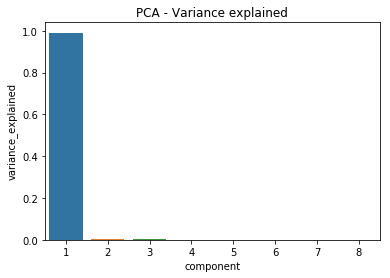

In [35]:
components = 8
pca = PCA(n_components=components).fit(train_X)
#Show explained variance for each component
pca_variance_explained_df = pd.DataFrame({
    "component": np.arange(1, components+1),
    "variance_explained": pca.explained_variance_ratio_            
    })

ax = sns.barplot(x='component', y='variance_explained', data=pca_variance_explained_df)
ax.set_title("PCA - Variance explained")
plt.show()


In [36]:
# X_pca = pd.DataFrame(pca.transform(train_X)[:,:2])
# X_pca['target'] = train_y.values
# X_pca.columns = ["x", "y", "target"]

# sns.lmplot('x','y', 
#            data=X_pca, 
#            hue="target", 
#            fit_reg=False, 
#            markers=["o", "x"], 
#            palette="Set1", 
#            size=7,
#            scatter_kws={"alpha": .2}
#           )
# plt.show()


#### Modelling

In [37]:
from sklearn.pipeline import make_pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import Imputer

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier

In [38]:
#Impute missing values after train test split
# my_imputer = SimpleImputer()
# train_X_imputed = pd.DataFrame(my_imputer.fit_transform(train_X.values))
# test_X_imputed = pd.DataFrame(my_imputer.fit_transform(test_X.values))


In [39]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
train_X_scaled=scaler.fit_transform(train_X)
test_X_scaled=scaler.fit_transform(test_X)

In [40]:
from sklearn.metrics import roc_auc_score
def multiclass_roc_dict(y_test,y_pred):
    #creating a set of all the unique classes using the actual class list
    unique_class = set(y_test.values)
    roc_auc_dict = {}
    for per_class in unique_class:
        #creating a list of all the classes except the current class 
        other_class = [x for x in unique_class if x != per_class]

        #marking the current class as 1 and all other classes as 0
        new_actual_class = [0 if x in other_class else 1 for x in y_test]
        new_pred_class = [0 if x in other_class else 1 for x in y_pred]

        #using the sklearn metrics method to calculate the roc_auc_score
        roc_auc = roc_auc_score(new_actual_class, new_pred_class, average = 'macro')
        roc_auc_dict[per_class] = roc_auc
    return roc_auc_dict

In [41]:
# Decision Tree
def get_multiclass_roc_dict(max_leaf_nodes, train_X, test_X, train_y, test_y):
    model = DecisionTreeClassifier(max_leaf_nodes=max_leaf_nodes, random_state=0)
    model.fit(train_X, train_y)
    preds_y = model.predict(test_X)
    multiclass_roc = multiclass_roc_dict(test_y, preds_y)
    return(multiclass_roc)

In [42]:
print("Decision Tree results with different number of leaf nodes:")
for max_leaf_nodes in [5, 50, 500, 5000,50000]:
    my_multiclass_roc_dict = get_multiclass_roc_dict(max_leaf_nodes, train_X_scaled, test_X_scaled, train_y, test_y)
    print("Max leaf nodes: %d" %(max_leaf_nodes))
    print(my_multiclass_roc_dict)

Decision Tree results with different number of leaf nodes:
Max leaf nodes: 5
{1: 0.9046990465052598, 2: 0.8393574549364486, 3: 0.6992517237325292}
Max leaf nodes: 50
{1: 0.9044516151341706, 2: 0.8310788102337409, 3: 0.7882727404753836}
Max leaf nodes: 500
{1: 0.9004104697192912, 2: 0.8216006934602086, 3: 0.8178135740911072}
Max leaf nodes: 5000
{1: 0.8846123232505114, 2: 0.7964301689875696, 3: 0.8052024910269089}
Max leaf nodes: 50000
{1: 0.8846123232505114, 2: 0.7964301689875696, 3: 0.8052024910269089}


In [43]:
# Random Forest
forest_model = RandomForestClassifier(random_state=99)
forest_model.fit(train_X_scaled, train_y)
preds_y = forest_model.predict(test_X_scaled)
print("Random Forest Results")
print(multiclass_roc_dict(test_y, preds_y))

Random Forest Results
{1: 0.9052945328959892, 2: 0.8501291566648368, 3: 0.8280138521013285}


In [44]:
# XGBoost
my_pipeline = make_pipeline(SimpleImputer(),XGBClassifier())
my_pipeline.fit(train_X_scaled, train_y)
preds_y = my_pipeline.predict(test_X_scaled)
print("XGBoost Results")
print(multiclass_roc_dict(test_y, preds_y))

XGBoost Results
{1: 0.905340483323733, 2: 0.8357734658777631, 3: 0.8313897399013824}


In [45]:
# XGBoost with parameters tuning 
xgb_model = XGBClassifier(n_estimators=100)
xgb_model.fit(train_X_scaled, train_y, verbose=False)
preds_y = xgb_model.predict(test_X_scaled)
print("XGBoost Results with Parameter Tuning")
print(multiclass_roc_dict(test_y, preds_y))

XGBoost Results with Parameter Tuning
{1: 0.905340483323733, 2: 0.8357734658777631, 3: 0.8313897399013824}


In [46]:
from sklearn.metrics import classification_report
# XGBoost with parameters tuning 
xgb_model = XGBClassifier(n_estimators=100)
xgb_model.fit(train_X_scaled, train_y.values, verbose=False)
preds_y = xgb_model.predict(test_X_scaled)
print("Classification Report : {}".format(classification_report(test_y, preds_y, labels=[1, 2, 3])))

Classification Report :               precision    recall  f1-score   support

           1       0.90      0.87      0.89      2059
           2       0.85      0.81      0.83      2481
           3       0.57      0.74      0.64       637

   micro avg       0.82      0.82      0.82      5177
   macro avg       0.77      0.81      0.79      5177
weighted avg       0.84      0.82      0.83      5177



Confusion matrix, without normalization
[[1794  241   24]
 [ 148 2002  331]
 [  41  124  472]]
Normalized confusion matrix
[[0.87 0.12 0.01]
 [0.06 0.81 0.13]
 [0.06 0.19 0.74]]


<Figure size 432x288 with 0 Axes>

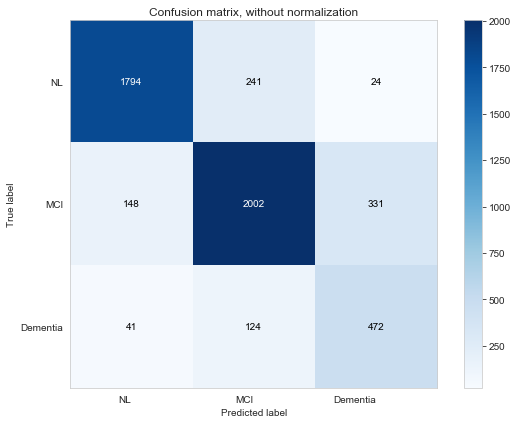

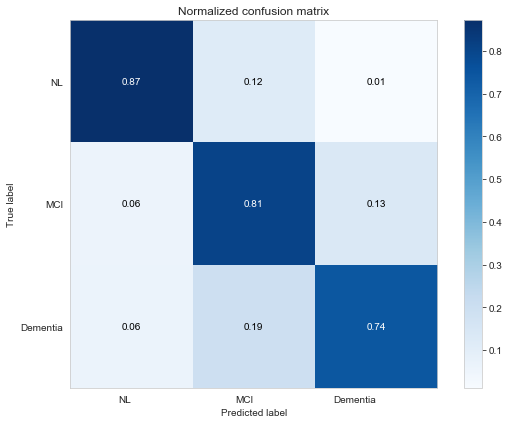

In [47]:
from sklearn.utils.multiclass import unique_labels
from sklearn.metrics import confusion_matrix
sns.set_style("whitegrid")
sns.despine()


def plot_confusion_matrix(y_true, y_pred,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    classes = unique_labels(df2['DX'])
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    fig, ax = plt.subplots(figsize = (8,6))
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=['NL','MCI','Dementia'], yticklabels=['NL','MCI','Dementia'],
           title=title,
           ylabel='True label',
           xlabel='Predicted label')
    # Turns off grid on the left Axis.
    ax.grid(False)
    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=0, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax

np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plot_confusion_matrix(test_y, preds_y,
                      title='Confusion matrix, without normalization')

# Plot normalized confusion matrix
plot_confusion_matrix(test_y, preds_y, normalize=True,
                      title='Normalized confusion matrix')

plt.show()

<Figure size 432x288 with 0 Axes>

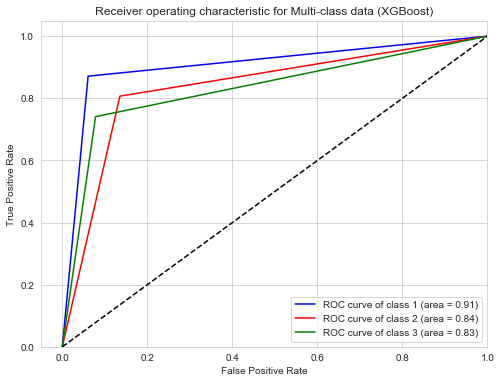

In [48]:
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc

sns.set_style("whitegrid")
sns.despine()
fig,ax = plt.subplots(figsize = (8,6))

# Binarize the output
y_bin = label_binarize(test_y, classes=[1, 2,3])
n_classes = y_bin.shape[1]

y_score = label_binarize(preds_y, classes=[1, 2,3])


fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_bin[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['blue', 'red', 'green']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i + 1, roc_auc[i] ))
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic for Multi-class data (XGBoost)')
plt.legend(loc="lower right")
plt.show()

In [49]:
from sklearn.ensemble import BaggingClassifier, ExtraTreesClassifier, GradientBoostingClassifier, VotingClassifier, RandomForestClassifier, AdaBoostClassifier
import xgboost as xgb
#Voting Ensemble
# Create sub models
estimators = []

estimators.append(('et', ExtraTreesClassifier(n_estimators=60,min_samples_split=8,max_features='sqrt',max_depth= 37)))
estimators.append(('gbm', GradientBoostingClassifier(subsample = 0.95,n_estimators= 32,
                 min_samples_split = 0.01,
                 min_samples_leaf = 10,
                 max_features = 'sqrt',
                 max_depth = 25,
                 loss = 'deviance',
                 learning_rate = 0.025,
                 criterion= 'friedman_mse')))
estimators.append(('rf', RandomForestClassifier(n_estimators=49,min_samples_split=25,max_features='auto',max_depth= 22)))
estimators.append(('ada', AdaBoostClassifier(n_estimators=37,learning_rate=0.2)))
#estimators.append(('svm', SVC(C = 25, gamma= 0.01, kernel ='linear')))
estimators.append(('xgb', xgb.XGBClassifier(psubsample= 0.6,
 silent= False,
 reg_lambda =0.1,
 n_estimators= 120,
 min_child_weight= 1.0,
 max_depth = 6,
 learning_rate= 0.01,
 gamma= 0.25,
 colsample_bytree=0.9,
 colsample_bylevel= 0.4)))

# create the ensemble model
ensemble = VotingClassifier(estimators, voting='soft', weights=[2,3,3,1,3])

In [50]:
model = ensemble

model.fit(train_X_scaled, train_y)
preds_y = model.predict(test_X_scaled)

In [51]:
from sklearn.metrics import roc_auc_score
def multiclass_roc_dict(y_test,y_pred):
    #creating a set of all the unique classes using the actual class list
    unique_class = set(y_test.values)
    roc_auc_dict = {}
    for per_class in unique_class:
        #creating a list of all the classes except the current class 
        other_class = [x for x in unique_class if x != per_class]

        #marking the current class as 1 and all other classes as 0
        new_actual_class = [0 if x in other_class else 1 for x in y_test]
        new_pred_class = [0 if x in other_class else 1 for x in y_pred]

        #using the sklearn metrics method to calculate the roc_auc_score
        roc_auc = roc_auc_score(new_actual_class, new_pred_class, average = 'macro')
        roc_auc_dict[per_class] = roc_auc
    return roc_auc_dict

In [52]:
print("Ensemble Results with Parameter Tuning")
print(multiclass_roc_dict(test_y, preds_y))

Ensemble Results with Parameter Tuning
{1: 0.9063759255895908, 2: 0.8528949840748142, 3: 0.8372668552341301}


In [53]:
from sklearn.metrics import classification_report

print("Classification Report : {}".format(classification_report(test_y, preds_y, labels=[1, 2, 3])))

Classification Report :               precision    recall  f1-score   support

           1       0.91      0.87      0.89      2059
           2       0.85      0.85      0.85      2481
           3       0.64      0.73      0.68       637

   micro avg       0.84      0.84      0.84      5177
   macro avg       0.80      0.82      0.81      5177
weighted avg       0.85      0.84      0.84      5177



Confusion matrix, without normalization
[[1791  245   23]
 [ 140 2098  243]
 [  38  132  467]]
Normalized confusion matrix
[[0.87 0.12 0.01]
 [0.06 0.85 0.1 ]
 [0.06 0.21 0.73]]


<Figure size 432x288 with 0 Axes>

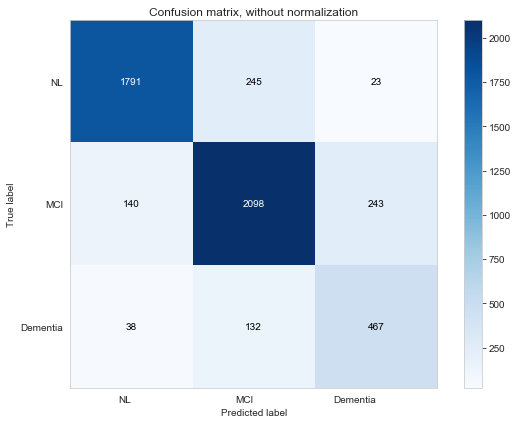

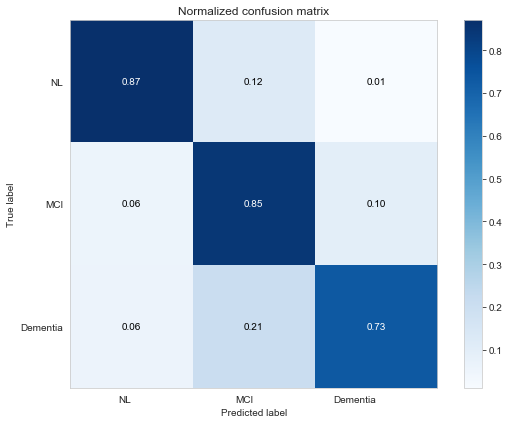

In [54]:
from sklearn.utils.multiclass import unique_labels
from sklearn.metrics import confusion_matrix
sns.set_style("whitegrid")
sns.despine()


def plot_confusion_matrix(y_true, y_pred,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    classes = unique_labels(df2['DX'])
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    fig, ax = plt.subplots(figsize = (8,6))
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=['NL','MCI','Dementia'], yticklabels=['NL','MCI','Dementia'],
           title=title,
           ylabel='True label',
           xlabel='Predicted label')
    # Turns off grid on the left Axis.
    ax.grid(False)

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=0, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax

np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plot_confusion_matrix(test_y, preds_y,
                      title='Confusion matrix, without normalization')

# Plot normalized confusion matrix
plot_confusion_matrix(test_y, preds_y, normalize=True,
                      title='Normalized confusion matrix')

plt.show()

<Figure size 432x288 with 0 Axes>

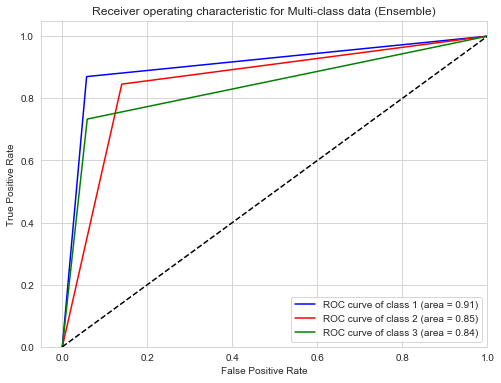

In [55]:
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc

sns.set_style("whitegrid")
sns.despine()
fig,ax = plt.subplots(figsize = (8,6))

# Binarize the output
y_bin = label_binarize(test_y, classes=[ 1, 2,3])
n_classes = y_bin.shape[1]

y_score = label_binarize(preds_y, classes=[1, 2,3])


fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_bin[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = ['blue', 'red', 'green']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i + 1, roc_auc[i] ))
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic for Multi-class data (Ensemble)')
plt.legend(loc="lower right")
plt.show()

In [57]:
import pickle
# save the model to disk
filename = 'finalized_model.sav'
pickle.dump(model, open(filename, 'wb'))
 
# # some time later...
 
# # load the model from disk
# loaded_model = pickle.load(open(filename, 'rb'))
# result = loaded_model.score(X_test, Y_test)
# print(result)
  


In [58]:
predictors=list(train_X.columns)
from sklearn.externals.six import StringIO
from sklearn.tree import DecisionTreeClassifier

dtc = DecisionTreeClassifier(min_samples_leaf=0.125, min_samples_split=0.125)
dtc = dtc.fit(train_X_scaled, train_y)
from sklearn import tree
tree.export_graphviz(dtc, out_file="tree_full_features.dot", feature_names=predictors, proportion=True)

#### Interpretability and Explainability

In [59]:
train_X.shape

(8841, 48)

In [60]:
import shap
import xgboost

# load JS visualization code to notebook
shap.initjs()

model = xgboost.train({"learning_rate": 0.01, "n_estimators": 100, "eval_set":[(test_X_scaled, test_y)] }, xgboost.DMatrix(train_X_scaled, train_y), 100)

# explain the model's predictions using SHAP values
# (same syntax works for LightGBM, CatBoost, and scikit-learn models)
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(train_X)

# visualize the first prediction's explanation (use matplotlib=True to avoid Javascript)
shap.force_plot(explainer.expected_value, shap_values[0,:], train_X.iloc[0,:])

In [61]:
# visualize the training set predictions
shap.force_plot(explainer.expected_value, shap_values, train_X)

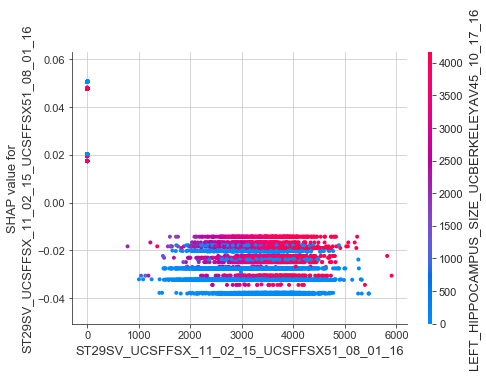

In [62]:
# create a SHAP dependence plot to show the effect of a single feature across the whole dataset
shap.dependence_plot("ST29SV_UCSFFSX_11_02_15_UCSFFSX51_08_01_16", shap_values, train_X)

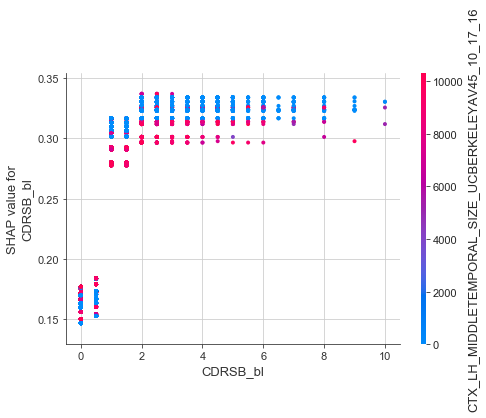

In [63]:
# create a SHAP dependence plot to show the effect of a single feature across the whole dataset
shap.dependence_plot("CDRSB_bl", shap_values, train_X)

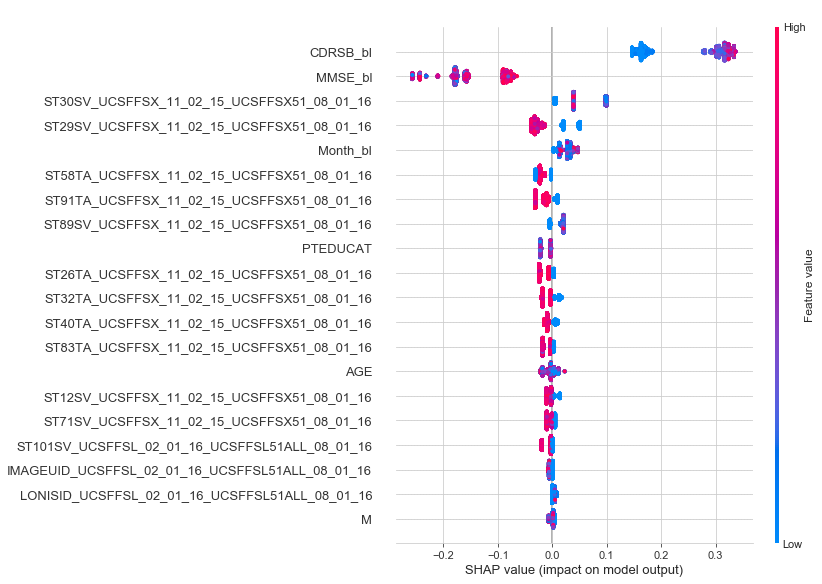

In [64]:
# summarize the effects of all the features
shap.summary_plot(shap_values, train_X)

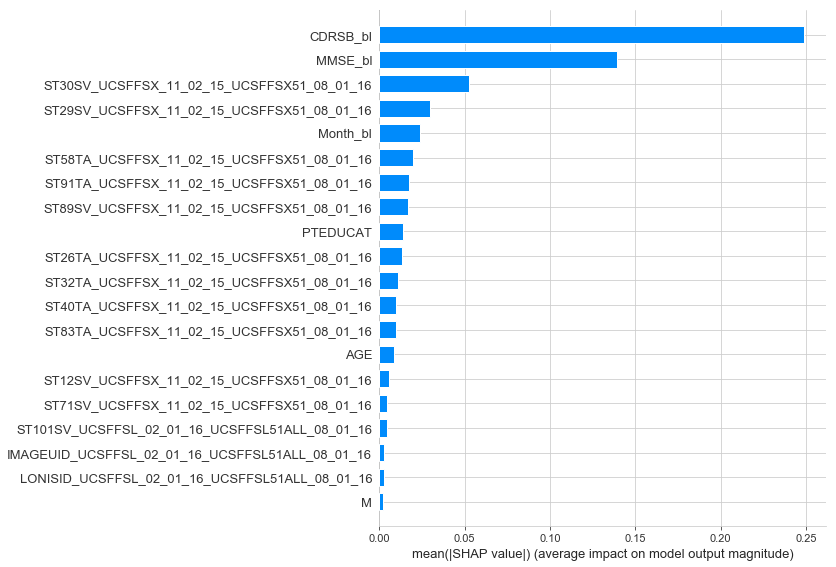

In [65]:
shap.summary_plot(shap_values, train_X, plot_type="bar")